In [1]:
import scanpy as sc
import os
import re
import anndata
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import loompy
import seaborn as sns
import pickle

import cell2location
import scvi
from PIL import Image
from src.utils import *
from src.classes import * 

from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42 # enables correct plotting of text for PDFsx

import math
import mygene
mg = mygene.MyGeneInfo()

/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/numba/core/cpu.py:97: UserWarning: Numba extension module 'sparse._numba_extension' failed to load due to 'ModuleNotFoundError(No module named 'numba.targets')'.
  numba.core.entrypoints.init_all()
OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
Global seed set to 0
2022-11-15 00:01:56.421895: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/cuda-11.4/lib64
2022-11-15 00:01:56.422872: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /usr/local/cuda-11.4/lib64
2022-11-15 00:01:56.422903: W te

In [37]:
results_folder = '../../results/cell2loc_res/L5_CTX_M_STR_CNS_Tax4_selection_1000_astro-merge_upd/'

ST_batch, sample_file = 'SN', '../../data/ST_files/SN.txt'
st_folder = '../../data/st_data_pre_processed/stdata_h5ad/'

sc_file = '../../data/sc_data/mouse_sc/L5_201022/L5_CTX_M_STR_CNS_description_selection_1000_astmerged_Tax4.pkl'
# create paths and names to results folders for reference regression and cell2location models

ref_run_name = f'{results_folder}reference_signatures/'

run_name = f'{results_folder}{ST_batch}/cell2location_map/' 

os.makedirs(ref_run_name, exist_ok=True)
os.makedirs(run_name, exist_ok=True)

In [3]:
def select_slide(adata, s, s_col='sample'):
    r""" This function selects the data for one slide from the spatial anndata object.

    :param adata: Anndata object with multiple spatial experiments
    :param s: name of selected experiment
    :param s_col: column in adata.obs listing experiment name for each location
    """

    slide = adata[adata.obs[s_col].isin([s]), :]
    s_keys = list(slide.uns['spatial'].keys())
    s_spatial = np.array(s_keys)[[s in k for k in s_keys]][0]

    slide.uns['spatial'] = {s_spatial: slide.uns['spatial'][s_spatial]}

    return slide

In [38]:
samples = pd.read_csv(sample_file, header=None, index_col=None)[0].to_list()
samples

['CN57_E1', 'CN57_E2', 'ST1_C1', 'ST1_C2', 'ST1_D2', 'CN53_E1', 'CN53_E2']

In [39]:
samples_list=[]
for sample in samples:
    h5_file = f'{st_folder}{sample}_stdata.h5ad'
    samples_list.append(sc.read_h5ad(h5_file))
adata_vis = ST_Anndata()
adata_vis.concat_anndata(samples_list, samples)
adata_vis = adata_vis.anndata
adata_vis.obs_names = adata_vis.obs['sample'].astype('str') + '_' + adata_vis.obs['feature'].astype('str')
adata_vis

<class 'anndata._core.anndata.AnnData'>


AnnData object with n_obs × n_vars = 4816 × 15172
    obs: 'feature', 'orig_feature', 'array_row', 'array_col', 'in_tissue', 'sample', 'slide', 'median_gene_feature', 'median_transcript_feature', 'x', 'y', 'new_x', 'new_y', 'pixel_x', 'pixel_y', 'n_transcripts', 'MT_perc', 'ribo_perc'
    var: 'ensembl_id', 'name', 'gene_id', 'species', 'value', 'Gene_no_alt', 'MT', 'ribo'
    uns: 'merged', 'sample', 'spatial'
    obsm: 'spatial'

/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value



vmax = 0.14853857457637787


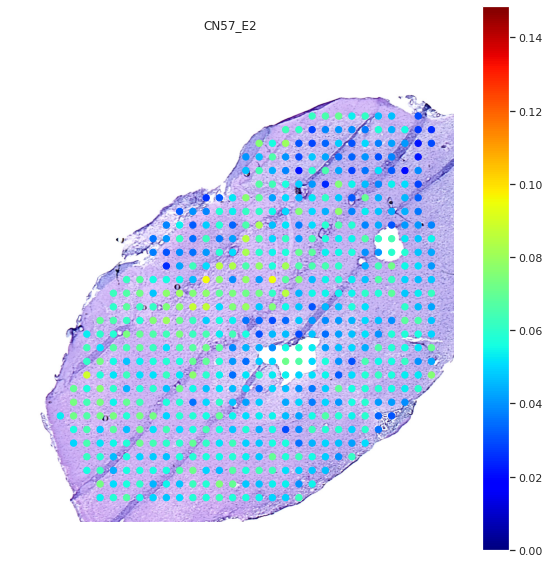

<Figure size 720x720 with 0 Axes>

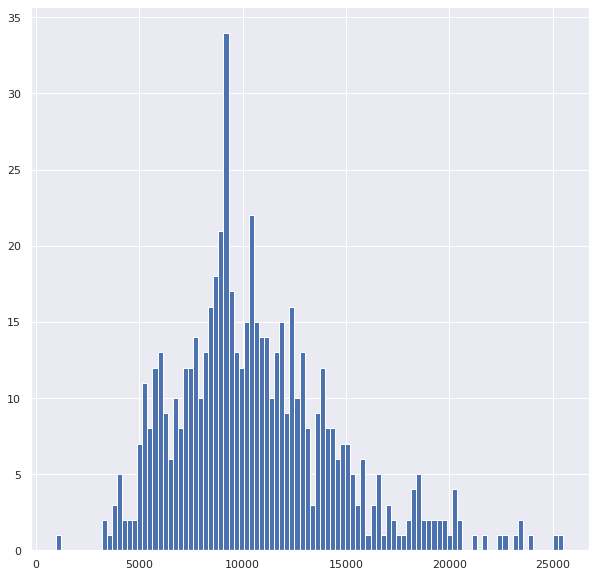

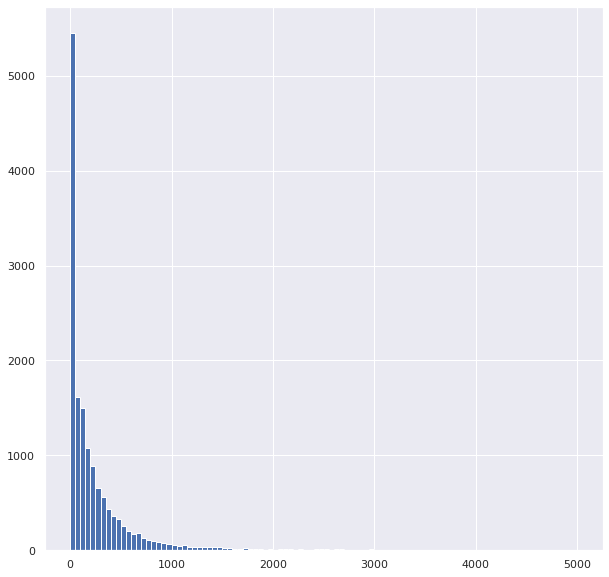

In [40]:
sample = samples[1]
c = np.sum(adata_vis[adata_vis.obs['sample'] == sample, :].X, axis=1)
adata_vis.obsm['spatial']
x = select_slide(adata_vis, sample)
plot_ST(adata_vis, sample, color='MT_perc')
# lt.scatter(x.obsm['spatial'][:, 0], x.obsm['spatial'][:, 1], c=c)
plt.show()
plt.hist(x.X.sum(axis=1).flatten(), bins=100)
plt.show()
plt.clf()
plt.hist(x.X.sum(axis=0).flatten(), range=[0, 5000], bins=100)
plt.show()

In [7]:
## load single cell data 
# sc_file = sc_file
        
if '.pkl' not in str(sc_file):
    print('new anndata')
    sc_obs = pd.read_csv(sc_path + [file for file in os.listdir(sc_path) if 'mta_data' in file][0], sep='\t', 
                     header=0, 
                     index_col=False)
    sc_obs.index = sc_path.split('/')[-2] + '_' + sc_obs['cell']
    
    sc_cnt = pd.read_csv(sc_path + [file for file in os.listdir(sc_path) if 'cnt_data' in file][0], sep='\t',
                    index_col=0,
                    header=0)
    
    sc_var = pd.DataFrame(sc_cnt.columns)
    sc_var.columns = ['SYMBOL']
    sc_var.index = sc_var['SYMBOL']
    
    sc_adata = anndata.AnnData(obs=sc_obs, var=sc_var, X = sc_cnt.iloc[:,:].to_numpy())

    outfile = open(sc_path + filename,'wb')
    pickle.dump(sc_adata, outfile)
    outfile.close()
else:
    print('found a pickle!')
    with open(sc_file,'rb') as infile:
        sc_adata = pickle.load(infile)

found a pickle!


/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/pandas/core/arraylike.py:405: RuntimeWarning: divide by zero encountered in log10
  result = getattr(ufunc, method)(*inputs, **kwargs)


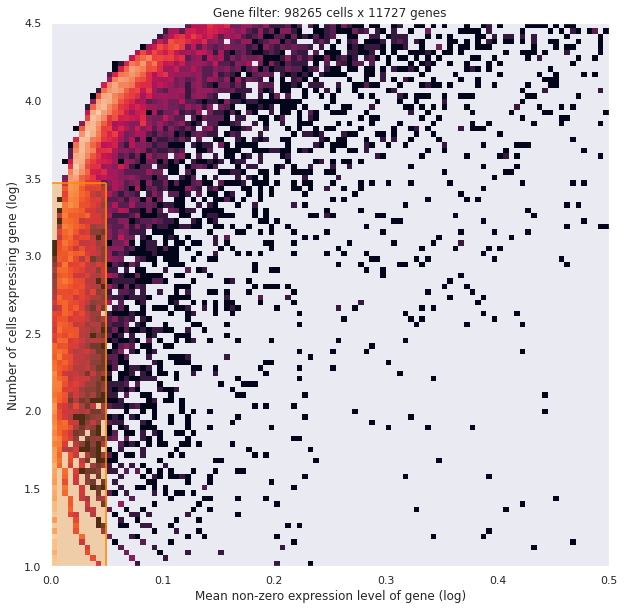

In [9]:
# Read data
adata_ref = sc_adata.copy()

from cell2location.utils.filtering import filter_genes
selected = filter_genes(adata_ref, cell_count_cutoff=5, cell_percentage_cutoff2=0.03, nonz_mean_cutoff=1.12)

# filter the object
adata_ref = adata_ref[:, selected].copy()

In [10]:
adata_ref.obs['ChipID'].value_counts()
keep_batch = adata_ref.obs['ChipID'].value_counts()[adata_ref.obs['ChipID'].value_counts() >= 3].index
adata_ref = adata_ref[adata_ref.obs['ChipID'].isin(keep_batch), :]

In [11]:
# prepare anndata for the regression model
cell2location.models.RegressionModel.setup_anndata(adata=adata_ref,
                        # 10X reaction / sample / batch
                        batch_key='ChipID',
                        # cell type, covariate used for constructing signatures
                        labels_key='Celltype_assigned',
                        #categorical_covariate_keys=['PCRCycles']                          
                       )
# create the regression model
from cell2location.models import RegressionModel
mod = RegressionModel(adata_ref)

# view anndata_setup as a sanity check
mod.view_anndata_setup()

/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/cell2location/models/reference/_reference_model.py:112: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs["_indices"] = np.arange(adata.n_obs).astype("int64")


Anndata setup with scvi-tools version 0.17.3.

Setup via `RegressionModel.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'ChipID',
│   'labels_key': 'Celltype_assigned',
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': None
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│          n_vars          │ 11727 │
│         n_cells          │ 98263 │
│         n_batch          │  32   │
│         n_labels         │  21   │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   0   │
└──────────────────────────┴───────┘

               Data Registry                
┏━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Registry Key ┃    scvi-tools Location    ┃
┡━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│      X       │          adata.X          │
│    batch     │ adata.obs['_scvi_batch']  │
│    labels    │ adata.obs['_scvi_labels'] │
│    ind_x     │   adata.obs['_indices']   │
└──────────────┴───────────────────────────┘

                   batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃   Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['ChipID'] │   10X01    │          0          │
│                     │   10X02    │          1          │
│                     │   10X04    │          2          │
│                     │   10X05    │          3          │
│                     │   10X06    │          4          │
│                     │   10X07    │          5          │
│                     │   10X11    │          6          │
│                     │   10X19    │          7          │
│                     │   10X20    │          8          │
│                     │   10X22    │          9          │
│                     │   10X24    │         10          │
│                     │   10X26    │         11          │
│                     │   10X28    │         12          │
│                     │   10X33    │         13          │
│                     │   10X34    │         14          │
│                     │   10X35    │         15          │
│                     │   10X36    │         16          │
│                     │   10X38    │         17          │
│                     │   10X43    │         18          │
│                     │   10X46    │         19          │
│                     │   10X48    │         20          │
│                     │   10X49    │         21          │
│                     │   10X50    │         22          │
│                     │   10X51    │         23          │
│                     │   10X52    │         24          │
│                     │   10X53    │         25          │
│                     │   10X54    │         26          │
│                     │   10X55    │         27          │
│                     │   10X56    │         28          │
│                     │   10X57    │         29          │
│                     │   10X75    │         30          │
│                     │   10X86    │         31          │
└─────────────────────┴────────────┴─────────────────────┘

                                    labels State Registry                                    
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━┓
┃       Source Location       ┃                Categories                ┃ scvi-tools Encod ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━┩
│ adata.obs['Celltype_assigne │            Astrocytes; mouse             │        0         │
│                             │     Cholinergic interneurons; mouse      │        1         │
│                             │    Cortical projection neurons; mouse    │        2         │
│                             │      D1 Medium Spiny Neurons; mouse      │        3         │
│                             │   D1/D2 Medium Spiny Neurons, striatum   │        4         │
│                             │      D2 Medium Spiny Neurons; mouse      │        5         │
│                             │   Dentate gyrus radial glia-like cells   │        6         │
│                             │ Di- and mesencephalon excitatory neurons │        7         │
│                             │ Di- and mesencephalon inhibitory neurons │        8         │
│                             │       Dopaminergic neurons; mouse        │        9         │
│                             │           Immune cells; mouse            │        10        │
│                             │       Inhibitory neurons, midbrain       │        11        │
│                             │    Inhibitory neurons, septal nucleus    │        12        │
│                             │      Non-glutamatergic neuroblasts       │        13        │
│                             │     Oligodendrocyte precursor cells      │        14        │
│                             │             Oligodendrocytes             │        15        │
│                             │ Subventricular zone radial glia-like cel │        16        │
│                             │  Telencephalon inhibitory interneurons   │        17        │
│                             │ Telencephalon projecting excitatory neur │        18        │
│                             │   Vascular leptomeningeal cells; mouse   │        19        │
│                             │             Vascular; mouse              │        20        │
└─────────────────────────────┴──────────────────────────────────────────┴──────────────────┘

In [12]:
mod.train(max_epochs=650, use_gpu=True)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/pytorch_lightning/trainer/configuration_validator.py:131: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Epoch 1/650:   0%|                                                | 0/650 [00:00<?, ?it/s]

/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/torch/distributions/gamma.py:71: UserWarning: Specified kernel cache directory could not be created! This disables kernel caching. Specified directory is /home/lcadmin/.cache/torch/kernels. This warning will appear only once per process. (Triggered internally at  /opt/conda/conda-bld/pytorch_1646756402876/work/aten/src/ATen/native/cuda/jit_utils.cpp:860.)
  self.rate * value - torch.lgamma(self.concentration))


Epoch 650/650: 100%|█████| 650/650 [1:24:46<00:00,  7.83s/it, v_num=1, elbo_train=4.69e+8]


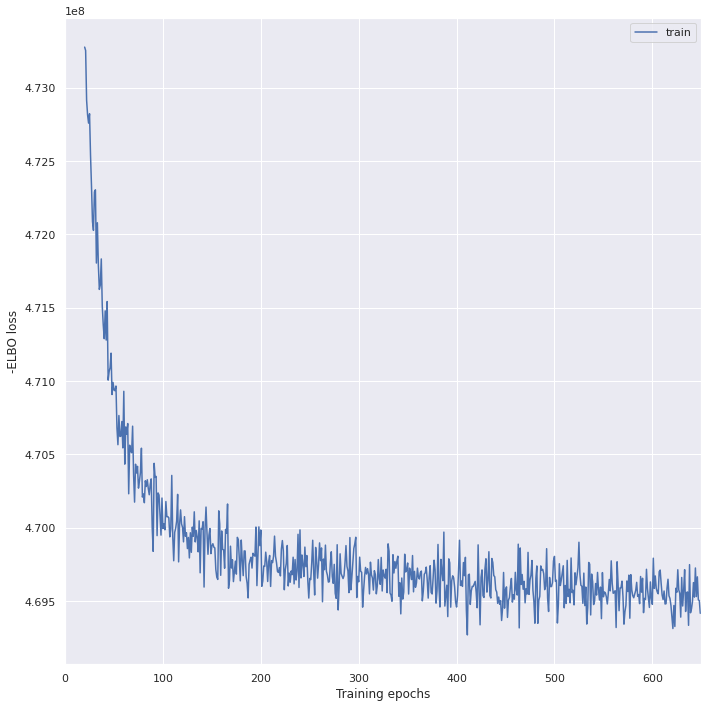

In [13]:
mod.plot_history(20)

In [14]:
mod.save(f"{ref_run_name}", overwrite=True)

In [15]:
# In this section, we export the estimated cell abundance (summary of the posterior distribution).
adata_ref = mod.export_posterior(
    adata_ref, sample_kwargs={'num_samples': 1000, 'batch_size': 2500, 'use_gpu': True}
)

# Save model
mod.save(f"{ref_run_name}", overwrite=True)

# Save anndata object with results
adata_file = f"{ref_run_name}sc.h5ad"
adata_ref.write_h5ad(adata_file)
adata_file

Sampling global variables, sample: 100%|████████████████| 999/999 [00:15<00:00, 65.29it/s]


'../../results/cell2loc_res/L5_CTX_M_STR_CNS_Tax4_selection_1000_astro-merge_upd/reference_signatures/sc.h5ad'

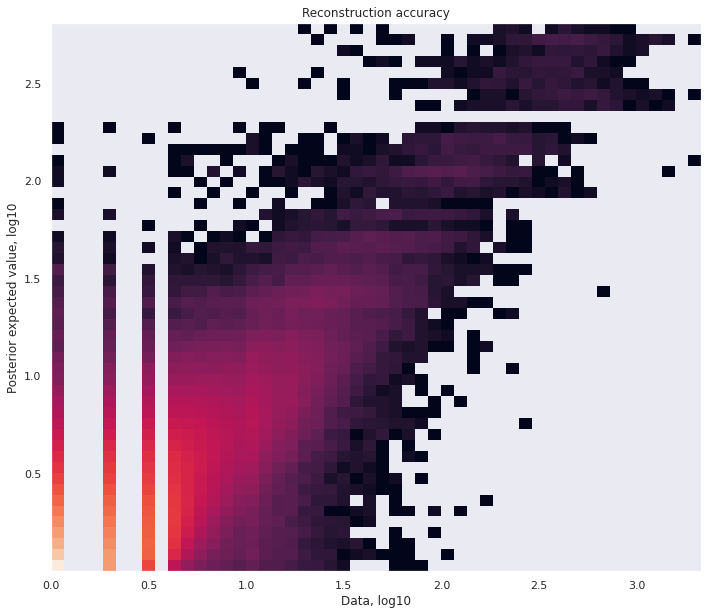

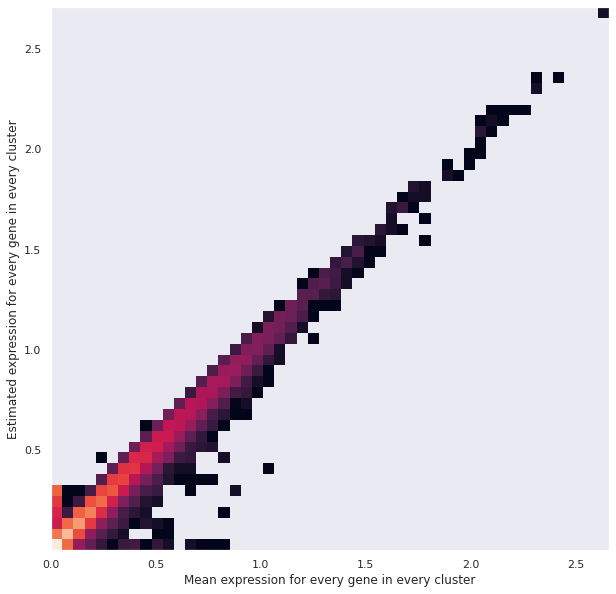

In [16]:
mod.plot_QC()

In [ ]:
adata_file = f"{ref_run_name}/sc.h5ad"
adata_ref = sc.read_h5ad(adata_file)
mod = cell2location.models.RegressionModel.load(f"{ref_run_name}", adata_ref)

In [17]:
adata_ref

AnnData object with n_obs × n_vars = 98263 × 11727
    obs: 'Age', 'AnalysisPool', 'CellID', 'Class', 'ClusterName', 'Description', 'Location_based_on', 'Mean Reads per Cell', 'Median UMI Counts per Cell', 'Neurotransmitter', 'Region', 'TaxonomyRank1', 'TaxonomyRank2', 'TaxonomyRank3', 'TaxonomyRank4', 'bio_celltype', 'ChipID', 'SampleID', 'SampleIndex', 'PCRCycles', 'Strain', 'Celltype_assigned', 'value', 'n_transcripts', 'Sample', '_indices', '_scvi_batch', '_scvi_labels'
    var: 'Accession', 'Gene', 'Gene_no_alt', 'value', 'n_cells', 'nonz_mean'
    uns: 'merged', '_scvi_uuid', '_scvi_manager_uuid', 'mod'
    varm: 'means_per_cluster_mu_fg', 'stds_per_cluster_mu_fg', 'q05_per_cluster_mu_fg', 'q95_per_cluster_mu_fg'

In [18]:
# export estimated expression in each cluster
if 'means_per_cluster_mu_fg' in adata_ref.varm.keys():
    inf_aver = adata_ref.varm['means_per_cluster_mu_fg'][[f'means_per_cluster_mu_fg_{i}'
                                    for i in adata_ref.uns['mod']['factor_names']]].copy()
else:
    inf_aver = adata_ref.var[[f'means_per_cluster_mu_fg_{i}'
                                    for i in adata_ref.uns['mod']['factor_names']]].copy()
inf_aver.columns = adata_ref.uns['mod']['factor_names']
inf_aver.loc[['TH', 'SLC6A3', 'COL1A1', 'PENK', 'PDYN', 'DRD1']].transpose()

symbol,TH,SLC6A3,COL1A1,PENK,PDYN,DRD1
Astrocytes; mouse,0.000235,0.000176,0.034215,0.001095,0.003351,0.000288
Cholinergic interneurons; mouse,0.452035,0.077651,0.005979,0.147918,0.047150,0.014199
Cortical projection neurons; mouse,0.000162,0.001443,0.000161,0.148402,0.040352,0.077534
D1 Medium Spiny Neurons; mouse,0.001689,0.000528,0.000749,0.164738,0.804486,1.617553
"D1/D2 Medium Spiny Neurons, striatum",0.017346,0.003488,0.009348,2.523074,0.373286,1.265008
D2 Medium Spiny Neurons; mouse,0.000566,0.000436,0.001284,11.609420,0.010281,0.018168
Dentate gyrus radial glia-like cells,0.004625,0.004010,0.004200,0.004241,0.004973,0.006272
Di- and mesencephalon excitatory neurons,0.035725,0.023817,0.016169,0.019409,0.021033,0.017474
Di- and mesencephalon inhibitory neurons,0.001452,0.002501,0.005251,0.098664,0.003017,0.083747
Dopaminergic neurons; mouse,4.750940,14.792844,0.012596,0.024148,0.013311,0.011492


In [41]:
well_transcript_average = []
for sample in samples:
    np_sample = adata_vis[adata_vis.obs['sample'] == sample, :].X
    well_transcript_average += [int(np.median(np.sum(np_sample, axis=1)))]*np_sample.shape[0]
well_transcript_average, 
len(well_transcript_average)

4816

In [42]:
adata_vis.obs['well_transcript_median'] = well_transcript_average
adata_vis.obs

,feature,orig_feature,array_row,array_col,in_tissue,sample,slide,median_gene_feature,median_transcript_feature,x,y,new_x,new_y,pixel_x,pixel_y,n_transcripts,MT_perc,ribo_perc,well_transcript_median
CN57_E1_X25.97_9.07,X25.97_9.07,X26_9,26.0,9.0,1,CN57_E1,CN57,2964.0,6411.0,26,9,25.97,9.07,1273.8,410.7,11329.0,0.058794,0.008072,6917
CN57_E1_X15.91_15.95,X15.91_15.95,X16_16,16.0,16.0,1,CN57_E1,CN57,2964.0,6411.0,16,16,15.91,15.95,769.8,760.9,7108.0,0.061282,0.010759,6917
CN57_E1_X25.96_6.08,X25.96_6.08,X26_6,26.0,6.0,1,CN57_E1,CN57,2964.0,6411.0,26,6,25.96,6.08,1273.0,258.4,7133.0,0.086389,0.012430,6917
CN57_E1_X26.36_14.98,X26.36_14.98,X26_15,26.0,15.0,1,CN57_E1,CN57,2964.0,6411.0,26,15,26.36,14.98,1293.0,711.6,6905.0,0.067739,0.011371,6917
CN57_E1_X3.84_20.84,X3.84_20.84,X4_21,4.0,21.0,1,CN57_E1,CN57,2964.0,6411.0,4,21,3.84,20.84,165.5,1010.2,6996.0,0.077986,0.008736,6917
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CN53_E2_X1.92_22.98,X1.92_22.98,X2_23,2.0,23.0,1,CN53_E2,CN53,2556.0,5077.0,2,23,1.92,22.98,72.7,1120.8,8963.0,0.051442,0.008680,5505
CN53_E2_X4.99_22.98,X4.99_22.98,X5_23,5.0,23.0,1,CN53_E2,CN53,2556.0,5077.0,5,23,4.99,22.98,220.8,1120.8,8691.0,0.047185,0.008981,5505
CN53_E2_X9.05_14.93,X9.05_14.93,X9_15,9.0,15.0,1,CN53_E2,CN53,2556.0,5077.0,9,15,9.05,14.93,416.2,715.1,6823.0,0.041716,0.009289,5505
CN53_E2_X19.73_19.97,X19.73_19.97,X20_20,20.0,20.0,1,CN53_E2,CN53,2556.0,5077.0,20,20,19.73,19.97,930.8,969.4,4294.0,0.051719,0.011914,5505


In [43]:
# find shared genes and subset both anndata and reference signatures
intersect = np.intersect1d(adata_vis.var_names, inf_aver.index)
adata_vis = adata_vis[:, intersect].copy()
inf_aver = inf_aver.loc[intersect, :].copy()

cell2location.models.Cell2location.setup_anndata(adata=adata_vis, batch_key="slide", continuous_covariate_keys=['well_transcript_median'])

In [44]:
# create and train the model
mod = cell2location.models.Cell2location(
    adata_vis, cell_state_df=inf_aver,
    # the expected average cell abundance: tissue-dependent
    # hyper-prior which can be estimated from paired histology:
    N_cells_per_location=50
    ,
    # hyperparameter controlling normalisation of
    # within-experiment variation in RNA detection:
    detection_alpha=20)
mod.view_anndata_setup()

Anndata setup with scvi-tools version 0.17.3.

Setup via `Cell2location.setup_anndata` with arguments:

{
│   'layer': None,
│   'batch_key': 'slide',
│   'labels_key': None,
│   'categorical_covariate_keys': None,
│   'continuous_covariate_keys': ['well_transcript_median']
}

         Summary Statistics         
┏━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━┓
┃     Summary Stat Key     ┃ Value ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━┩
│          n_vars          │ 9211  │
│         n_cells          │ 4816  │
│         n_batch          │   3   │
│         n_labels         │   1   │
│ n_extra_categorical_covs │   0   │
│ n_extra_continuous_covs  │   1   │
└──────────────────────────┴───────┘

                            Data Registry                            
┏━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃     Registry Key      ┃            scvi-tools Location            ┃
┡━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│           X           │                  adata.X                  │
│         batch         │         adata.obs['_scvi_batch']          │
│        labels         │         adata.obs['_scvi_labels']         │
│ extra_continuous_covs │ adata.obsm['_scvi_extra_continuous_covs'] │
│         ind_x         │           adata.obs['_indices']           │
└───────────────────────┴───────────────────────────────────────────┘

                  batch State Registry                   
┏━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃  Source Location   ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['slide'] │    CN53    │          0          │
│                    │    CN57    │          1          │
│                    │    ST1     │          2          │
└────────────────────┴────────────┴─────────────────────┘

                     labels State Registry                      
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━┓
┃      Source Location      ┃ Categories ┃ scvi-tools Encoding ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['_scvi_labels'] │     0      │          0          │
└───────────────────────────┴────────────┴─────────────────────┘

 extra_continuous_covs State Registry  
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃           Source Location           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│ adata.obs['well_transcript_median'] │
└─────────────────────────────────────┘

GPU available: True, used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/pytorch_lightning/trainer/configuration_validator.py:131: UserWarning: You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.
  rank_zero_warn("You passed in a `val_dataloader` but have no `validation_step`. Skipping val loop.")
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/pytorch_lightning/trainer/trainer.py:1933: PossibleUserWarning: The number of training batches (1) is smaller than the logging interval Trainer(log_every_n_steps=10). Set a lower value for log_every_n_steps if you want to see logs for the training epoch.
  rank_zero_warn(


Epoch 25000/25000: 100%|█| 25000/25000 [1:09:06<00:00,  6.03it/s, v_num=1, elbo_train=2.87


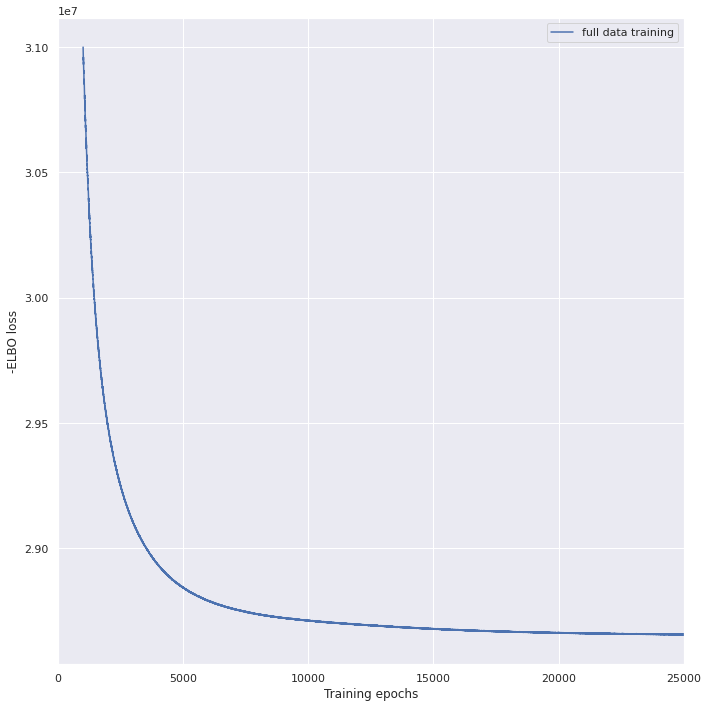

In [45]:
mod.train(max_epochs=25000,
          # train using full data (batch_size=None)
          batch_size=None,
          # use all data points in training because
          # we need to estimate cell abundance at all locations
          train_size=1,
          use_gpu=True)

# plot ELBO loss history during training, removing first 100 epochs from the plot
mod.plot_history(1000)
plt.legend(labels=['full data training']);

In [46]:
print(run_name)

../../results/cell2loc_res/L5_CTX_M_STR_CNS_Tax4_selection_1000_astro-merge_upd/SN/cell2location_map/


In [47]:
# In this section, we export the estimated cell abundance (summary of the posterior distribution).
adata_vis = mod.export_posterior(
    adata_vis, sample_kwargs={'num_samples': 1000, 'batch_size': mod.adata.n_obs, 'use_gpu': True}
)

# Save model
print(run_name)
mod.save(f"{run_name}", overwrite=True)

# mod = cell2location.models.Cell2location.load(f"{run_name}", adata_vis)

# Save anndata object with results
adata_file = f"{run_name}/sp.h5ad"
adata_vis.write(adata_file)
adata_file

Sampling global variables, sample: 100%|████████████████| 999/999 [00:30<00:00, 32.92it/s]
../../results/cell2loc_res/L5_CTX_M_STR_CNS_Tax4_selection_1000_astro-merge_upd/SN/cell2location_map/


'../../results/cell2loc_res/L5_CTX_M_STR_CNS_Tax4_selection_1000_astro-merge_upd/SN/cell2location_map//sp.h5ad'

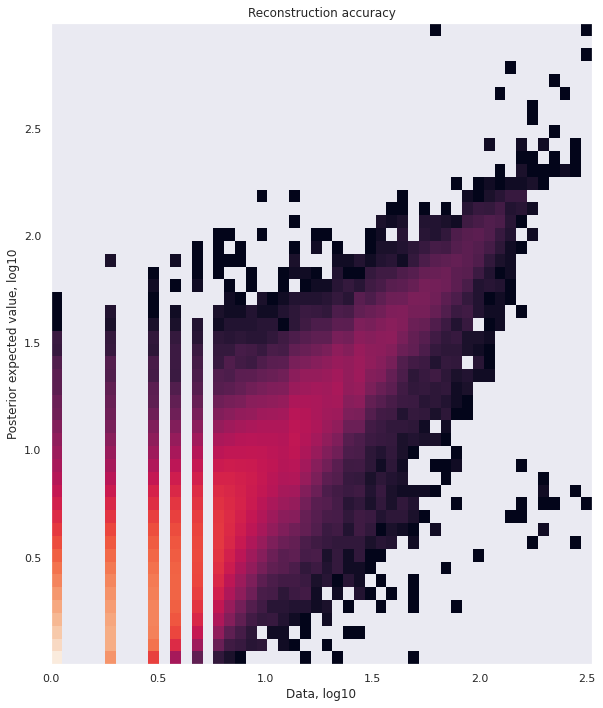

In [48]:
mod.plot_QC()

In [ ]:
adata_file = f"{run_name}/sp.h5ad"
adata_vis = sc.read(adata_file)
adata_vis

In [49]:
cell_types = sorted(adata_ref.obs['Celltype_assigned'].unique().to_list())
# cell_types = [ctype for ctype in cell_types if slide.obs[ctype].max()>2]
print(cell_types)

['Astrocytes; mouse', 'Cholinergic interneurons; mouse', 'Cortical projection neurons; mouse', 'D1 Medium Spiny Neurons; mouse', 'D1/D2 Medium Spiny Neurons, striatum', 'D2 Medium Spiny Neurons; mouse', 'Dentate gyrus radial glia-like cells', 'Di- and mesencephalon excitatory neurons', 'Di- and mesencephalon inhibitory neurons', 'Dopaminergic neurons; mouse', 'Immune cells; mouse', 'Inhibitory neurons, midbrain', 'Inhibitory neurons, septal nucleus', 'Non-glutamatergic neuroblasts', 'Oligodendrocyte precursor cells', 'Oligodendrocytes', 'Subventricular zone radial glia-like cells', 'Telencephalon inhibitory interneurons', 'Telencephalon projecting excitatory neurons', 'Vascular leptomeningeal cells; mouse', 'Vascular; mouse']


In [50]:
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = adata_vis.obsm['q05_cell_abundance_w_sf']

In [51]:
os.makedirs(f"{run_name}/ct_df", exist_ok=True)
for sample in samples:
    df = adata_vis.obs[adata_vis.obs['sample'] == sample][adata_vis.uns['mod']['factor_names']]
    df.index = adata_vis.obs[adata_vis.obs['sample'] == sample]['feature']
    df.to_csv(f"{run_name}/ct_df/{sample}_cell_proportions.tsv", sep='\t')

/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value
/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python

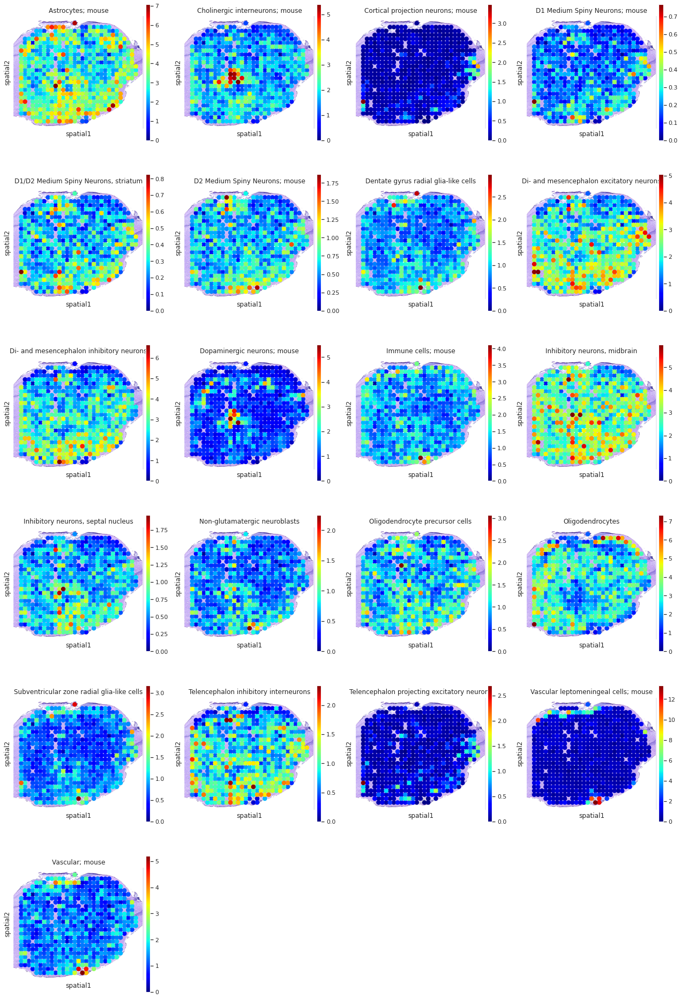

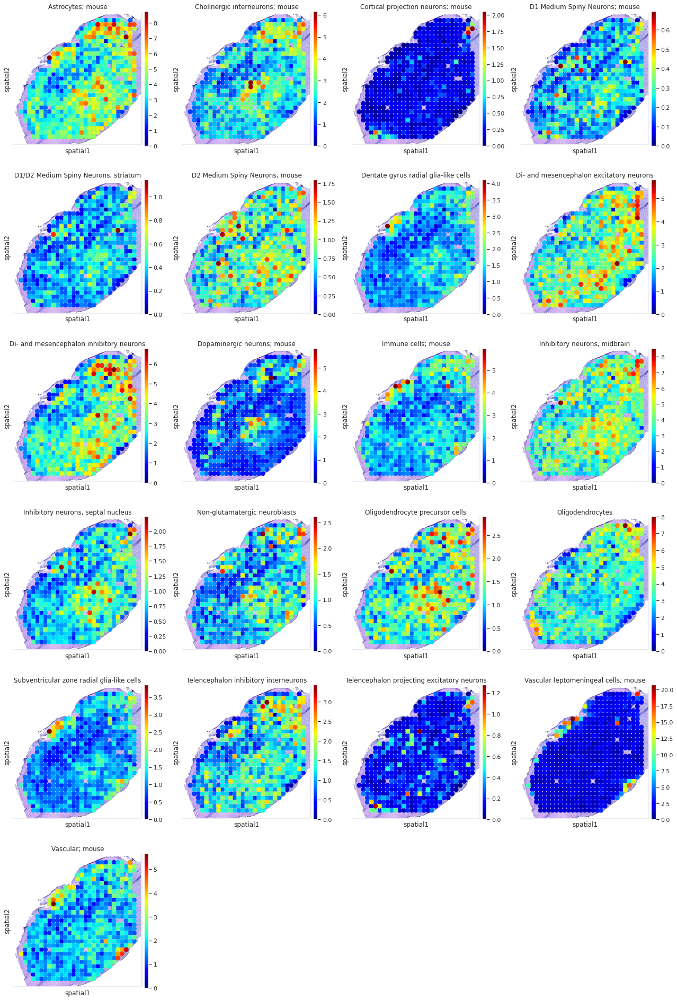

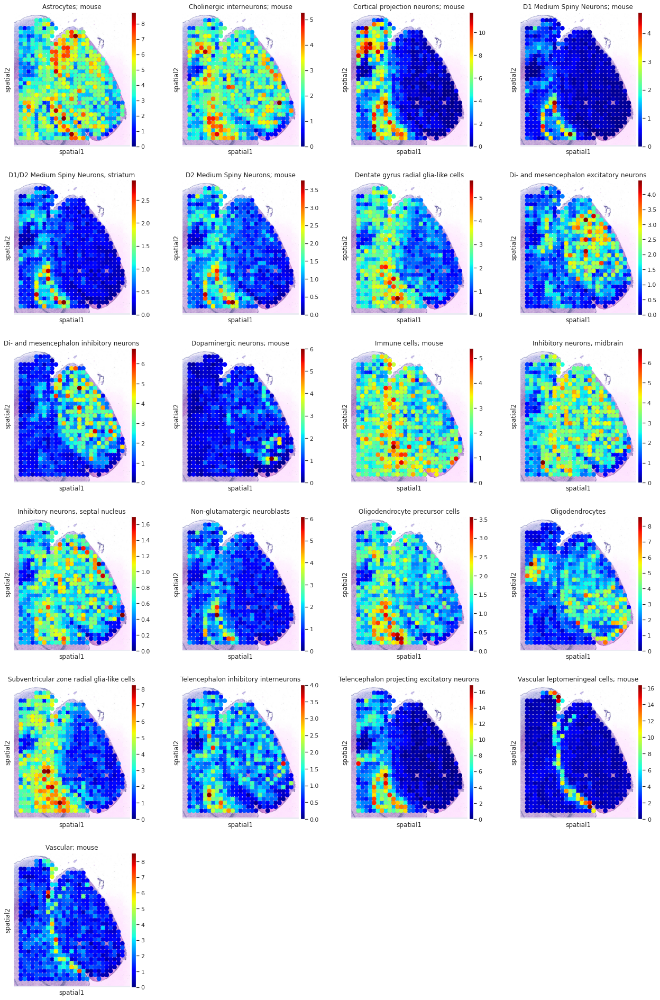

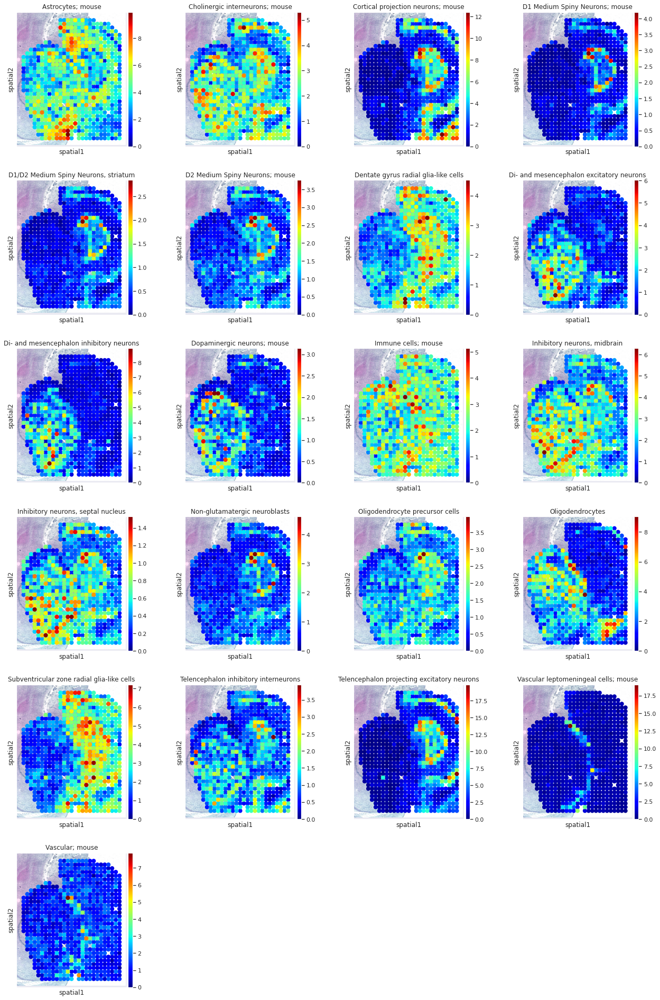

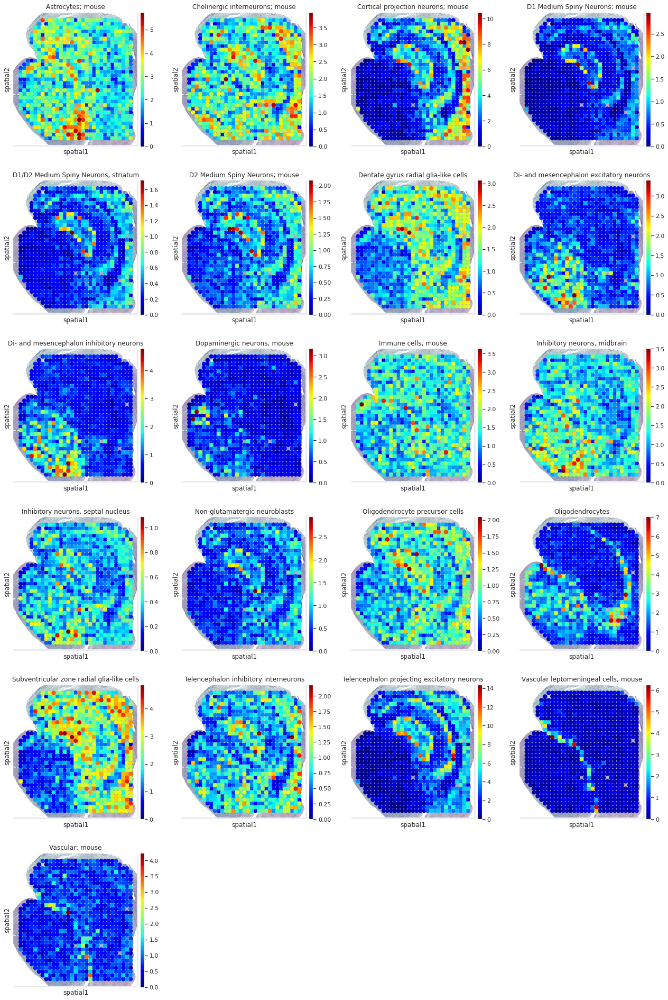

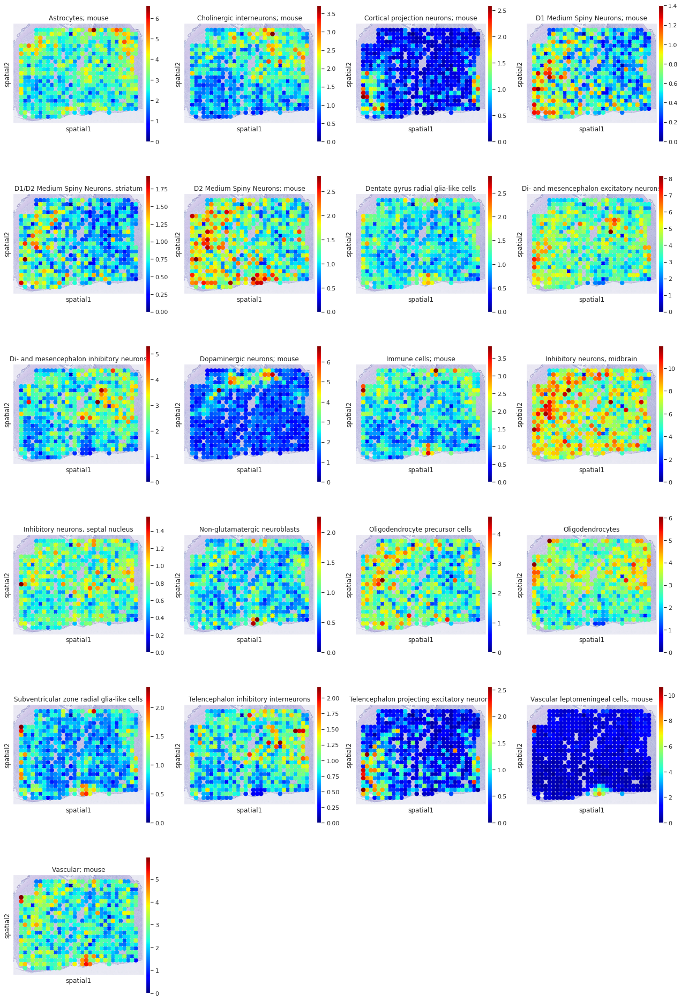

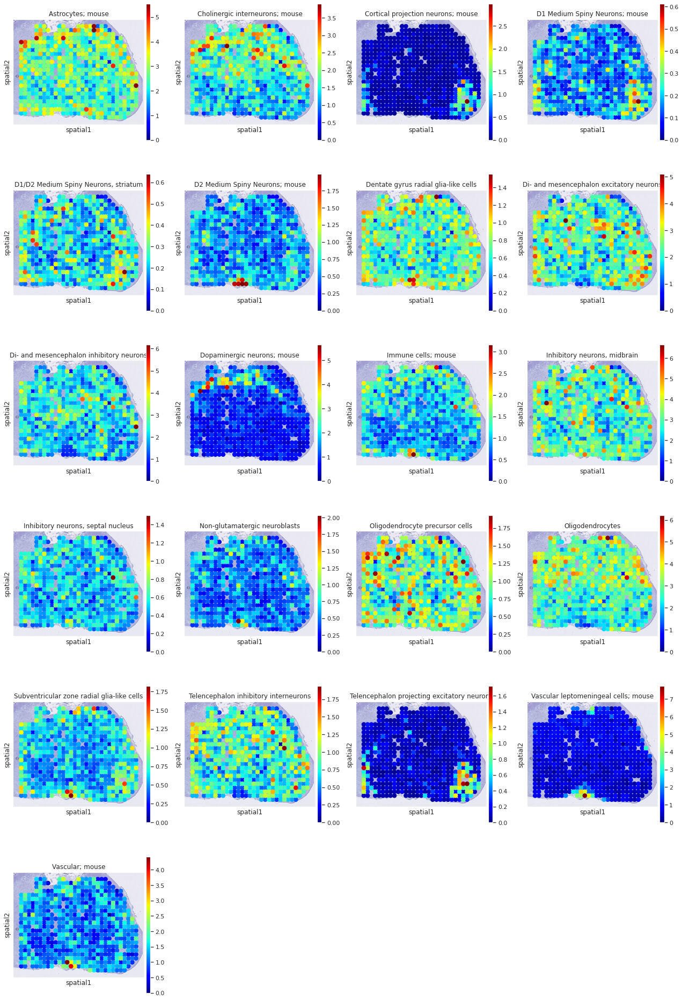

In [52]:
os.makedirs(f"{run_name}/plt", exist_ok=True)
for sample in samples:
    slide = select_slide(adata_vis, sample)
    with mpl.rc_context({'figure.figsize': [4.5, 5]}):
        sc.pl.spatial(slide, cmap='jet',
                      # show first 8 cell types
                      color=cell_types,
                      ncols=4, size=1.3,                   
                      img_key='hires',
                      # limit color scale at 99.2% quantile of cell abundance
                      vmin=0, show=False, return_fig=True
                     )
        plt.savefig(f"{run_name}/plt/{sample}_cell_proportions.png", bbox_inches='tight', dpi=500)

In [53]:
perc = adata_vis.obsm['q05_cell_abundance_w_sf'].div(adata_vis.obsm['q05_cell_abundance_w_sf'].sum(axis=1), axis=0)
adata_vis.obs[adata_vis.uns['mod']['factor_names']] = perc
vmax = perc.max().max()

CN57_E1


/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


CN57_E2


/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


ST1_C1


/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


ST1_C2


/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


ST1_D2


/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


CN53_E1


/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


CN53_E2


/home/lcadmin/miniconda3/envs/ST_pipeline/lib/python3.9/site-packages/anndata/compat/_overloaded_dict.py:106: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  self.data[key] = value


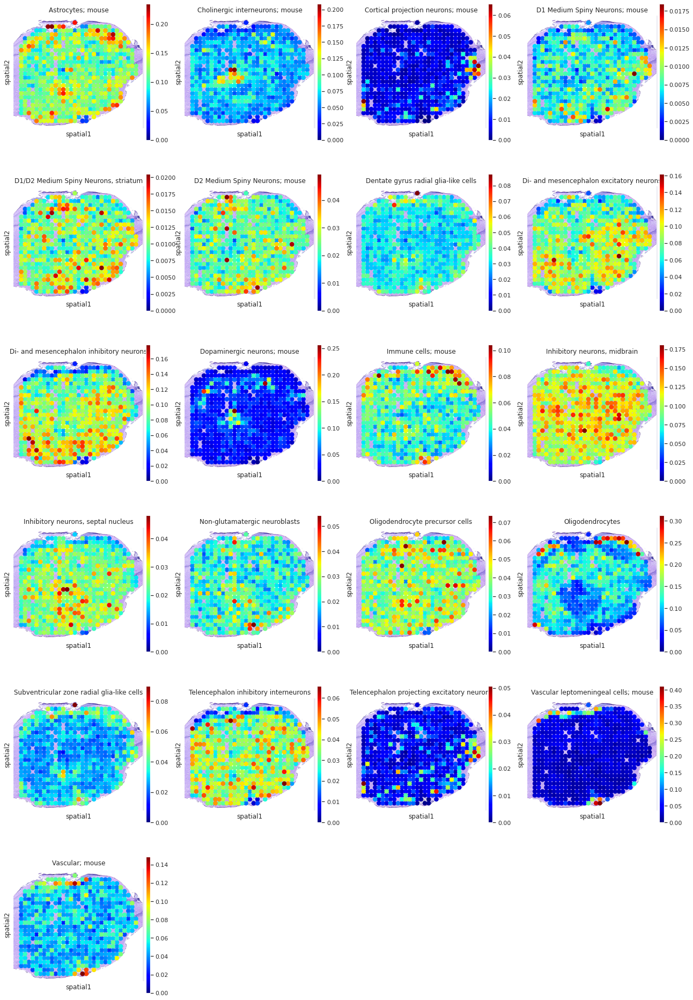

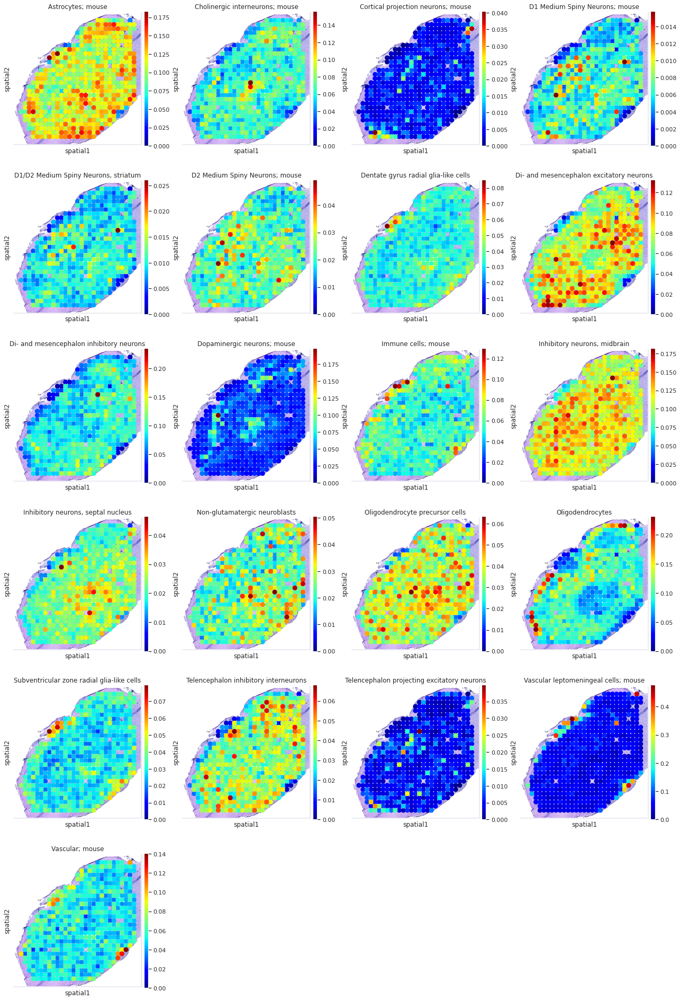

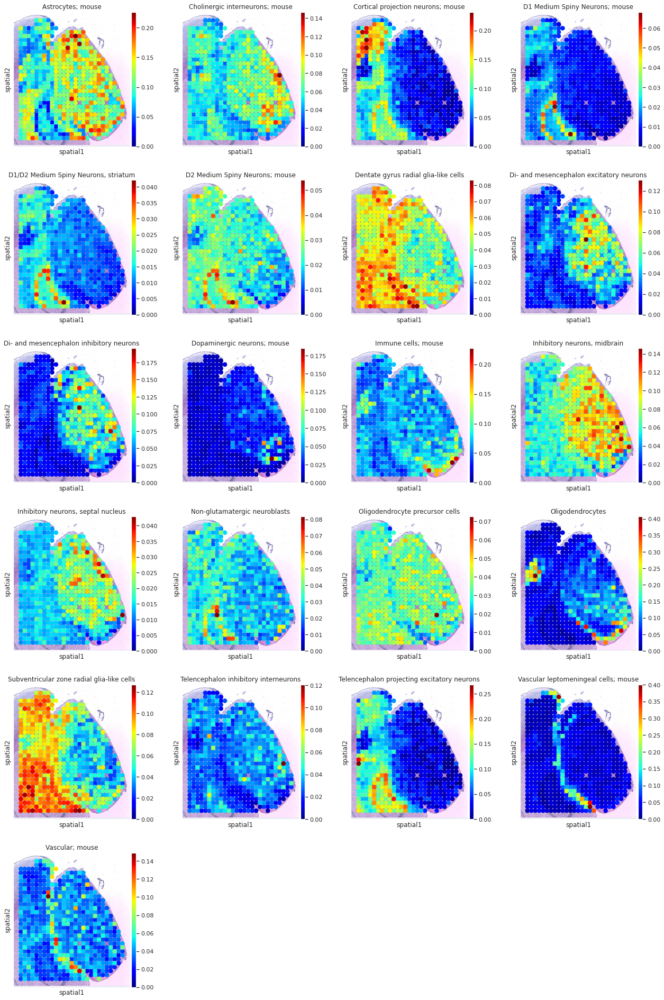

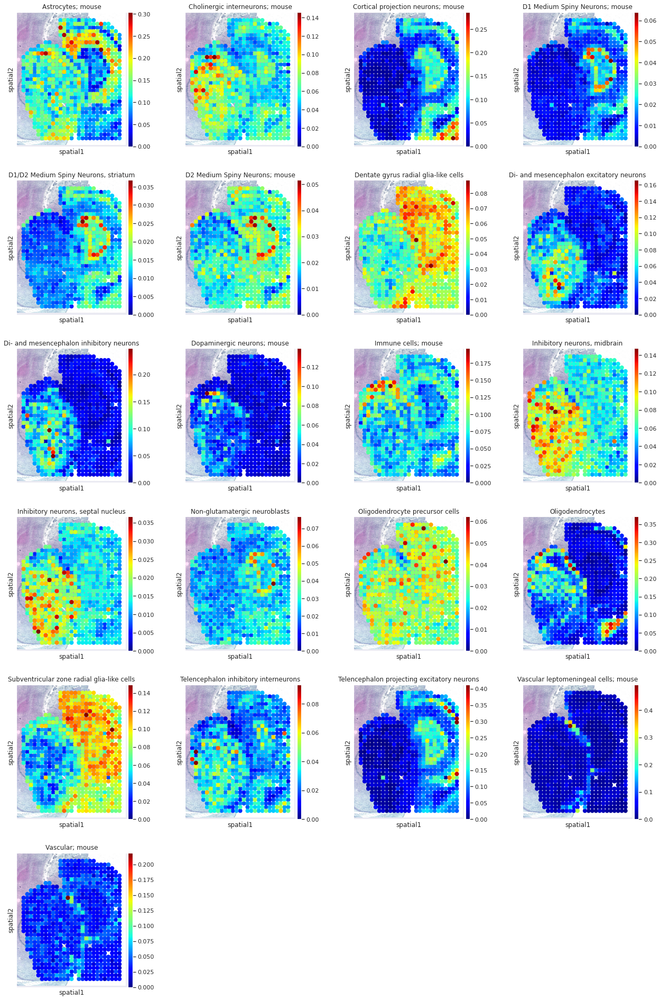

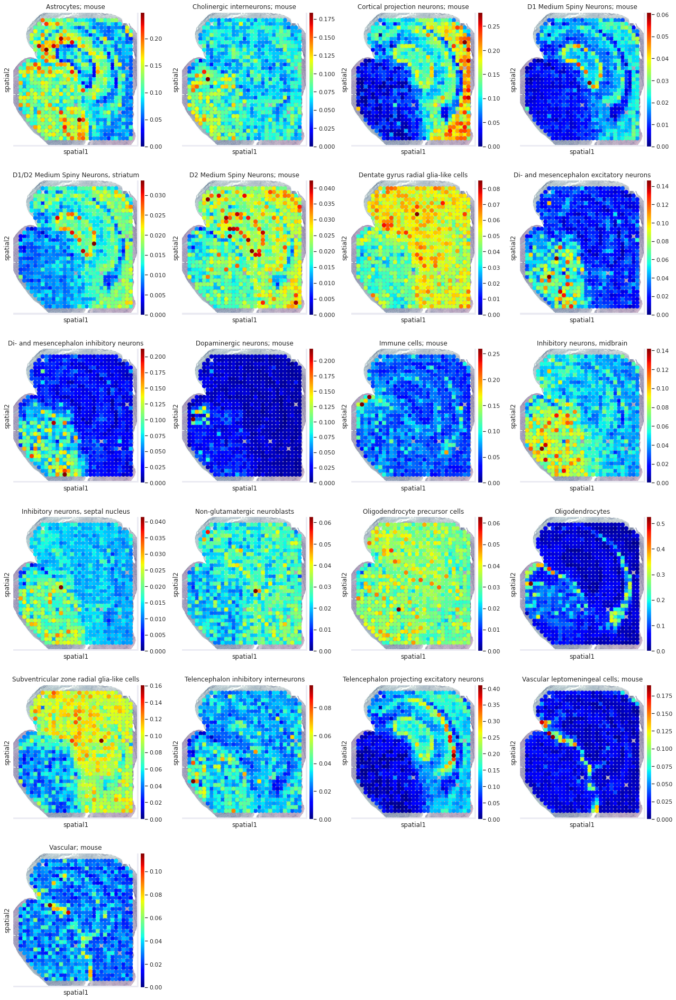

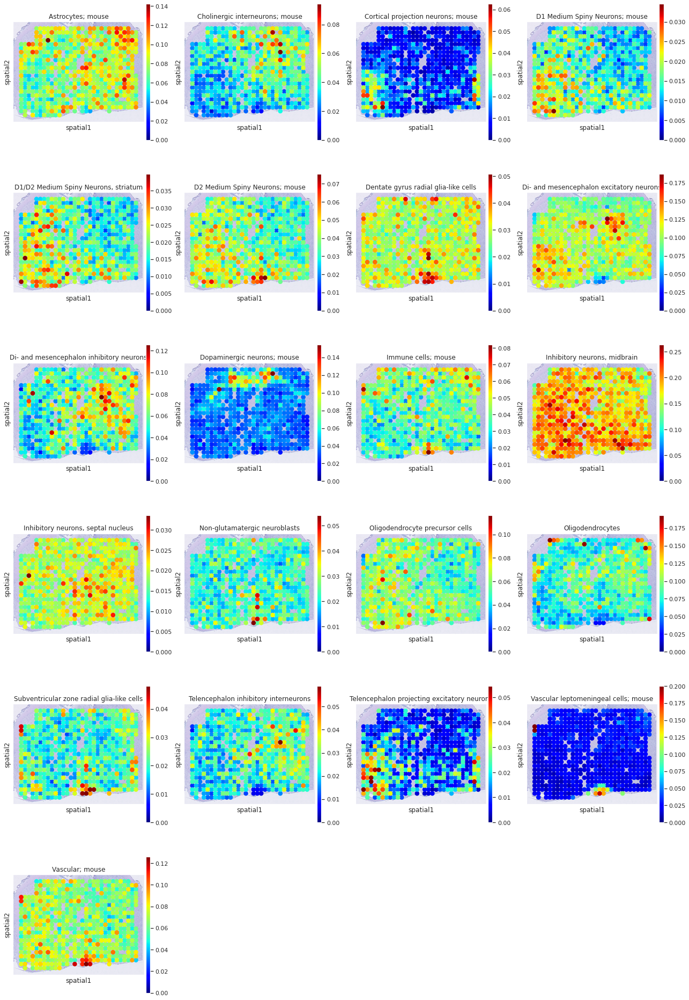

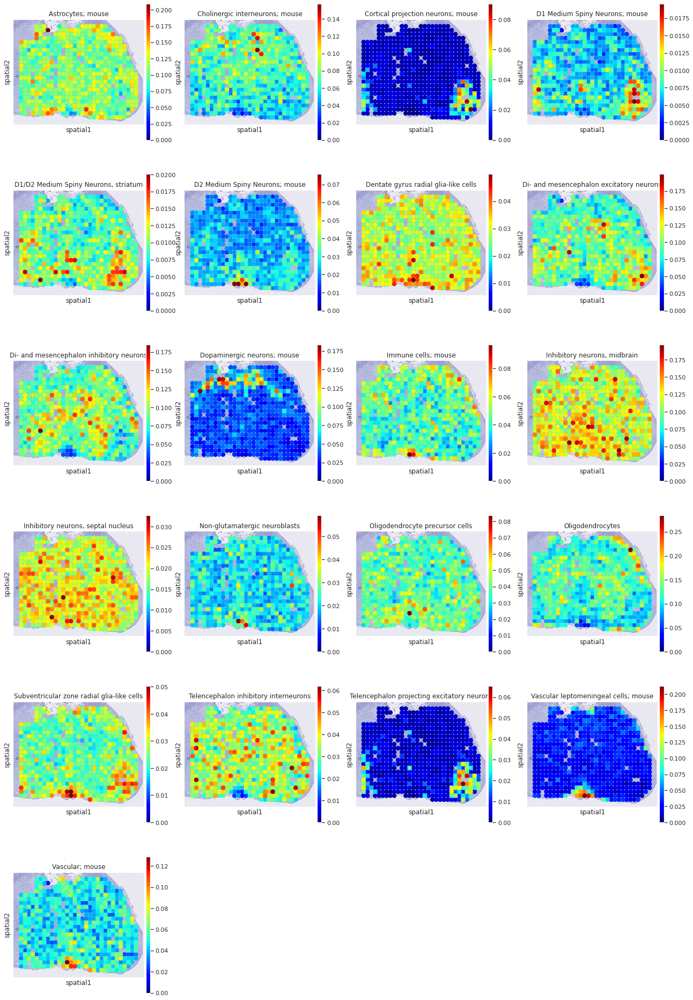

In [54]:
for sample in samples:
    print(sample)
    slide = select_slide(adata_vis, sample)
    vmax = slide.obs[adata_vis.uns['mod']['factor_names']].max().max()
    with mpl.rc_context({'figure.figsize': [4.5, 5]}):
        sc.pl.spatial(slide, cmap='jet',
                      # show first 8 cell types
                      color=cell_types,
                      ncols=4, size=1.3,                   
                      img_key='hires',
                      # limit color scale at 99.2% quantile of cell abundance
                      vmin=0, show=False, return_fig=True
                     )
        plt.savefig(f"{run_name}/plt/{sample}_cell_proportions_feature_perc.png", bbox_inches='tight', dpi=500)